# Convolutional Neural Network (CNN) with Prewitt Kernels

### **1. What is a CNN?**
A **Convolutional Neural Network (CNN)** is a deep learning model used for image processing tasks such as classification, detection, and segmentation. The key component of CNNs is the **convolution operation**, which applies a filter (kernel) over an image.

### **2. The Convolution Operation**
Given an input image I and a filter K, the convolution operation is defined as:

$$ S(i, j) = \sum_m \sum_n I(i+m, j+n) K(m, n) $$

where:
- $S(i, j)$ is the output feature map.
- $I(i+m, j+n)$ represents pixel values in the image.
- $K(m, n)$ is the convolutional kernel.

### **3. Prewitt Edge Detection Kernels**
Prewitt kernels are used for **edge detection** in an image by detecting horizontal and vertical changes.

- **Horizontal Prewitt Kernel**:
  
  $$ K_x =
  \begin{bmatrix}
  -1 & 0 & 1 \\
  -1 & 0 & 1 \\
  -1 & 0 & 1
  \end{bmatrix} $$

- **Vertical Prewitt Kernel**:
  
  $$ K_y =
  \begin{bmatrix}
  -1 & -1 & -1 \\
  0 & 0 & 0 \\
  1 & 1 & 1
  \end{bmatrix} $$

These kernels highlight edges in the horizontal and vertical directions by computing intensity differences in the image.

### **4. Applying Prewitt Filters**
The Prewitt operator works by convolving an image I with both kernels:

$$ G_x = I * K_x, \quad G_y = I * K_y $$

The final edge magnitude is given by:

$$ G = \sqrt{G_x^2 + G_y^2} $$

where G represents the detected edges.

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt

def apply_convolution(image, kernel):
    """
    Applies a convolution operation using the given kernel on an image.
    image: Input grayscale image.
    kernel: 3x3 Prewitt kernel.
    """
    image_height, image_width = image.shape
    kernel_size = kernel.shape[0]  # Assumes square kernel (3x3)
    pad = kernel_size // 2  # Padding size (1 for 3x3 kernel)
    
    # Pad image with zeros
    padded_image = np.pad(image, pad, mode='constant')
    output = np.zeros_like(image)
    
    # Apply convolution
    for i in range(image_height):
        for j in range(image_width):
            region = padded_image[i:i+kernel_size, j:j+kernel_size]
            output[i, j] = np.sum(region * kernel)
    
    return output

def prewitt_edge_detection(image_path):
    """
    Reads an image, applies Prewitt edge detection, and visualizes the results.
    """
    # Load image and convert to grayscale
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    if image is None:
        print("Error: Unable to load image.")
        return

    # Prewitt kernels
    prewitt_x = np.array([
        [-1, 0, 1],
        [-1, 0, 1],
        [-1, 0, 1]
    ])
    
    prewitt_y = np.array([
        [-1, -1, -1],
        [ 0,  0,  0],
        [ 1,  1,  1]
    ])
    
    gx = apply_convolution(image, prewitt_x)
    gy = apply_convolution(image, prewitt_y)
    
    gradient_magnitude = np.sqrt(gx**2 + gy**2)
    gradient_magnitude = (gradient_magnitude / gradient_magnitude.max()) * 255  # Normalize

    # visualization
    fig, ax = plt.subplots(1, 4, figsize=(16, 5), dpi=300)
    
    ax[0].imshow(image, cmap='gray')
    ax[0].set_title("Original Image")
    ax[0].axis("off")
    
    ax[1].imshow(gx, cmap='gray')
    ax[1].set_title("Prewitt - Horizontal Edges")
    ax[1].axis("off")
    
    ax[2].imshow(gy, cmap='gray')
    ax[2].set_title("Prewitt - Vertical Edges")
    ax[2].axis("off")
    
    ax[3].imshow(gradient_magnitude, cmap='gray')
    ax[3].set_title("Edge Magnitude")
    ax[3].axis("off")
    
    plt.show()

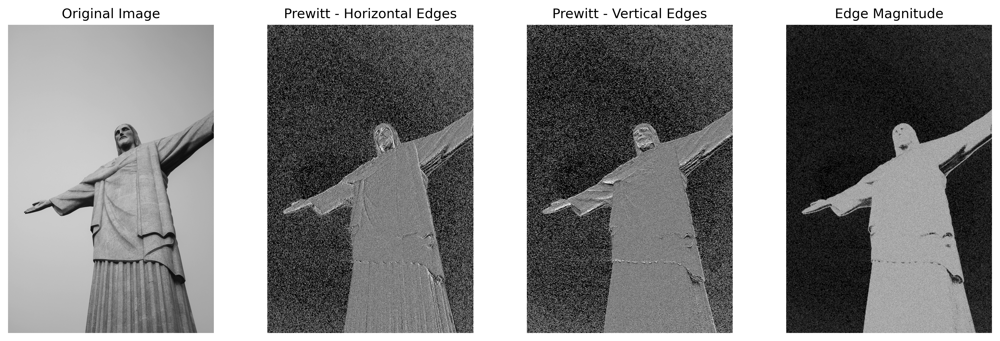

In [2]:
if __name__ == "__main__":
    image_path = "/Users/elizabeth/Desktop/pics/batch1/IMG_8477.jpg"  
    prewitt_edge_detection(image_path)

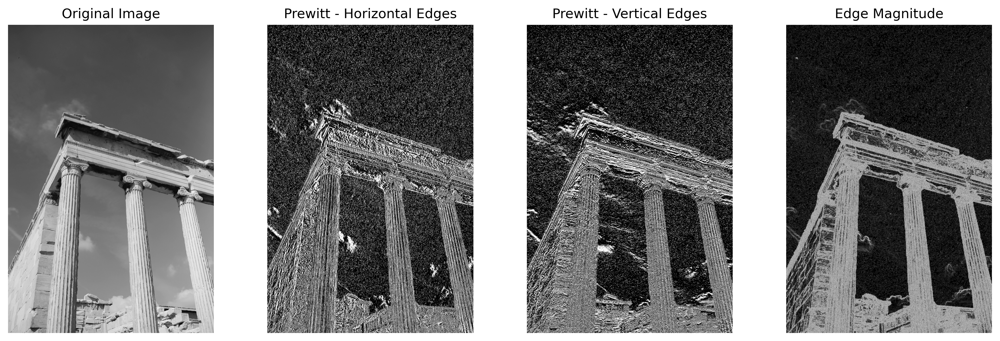

In [3]:
if __name__ == "__main__":
    image_path = "/Users/elizabeth/Desktop/pics/batch1/IMG_7149.jpg"  
    prewitt_edge_detection(image_path)

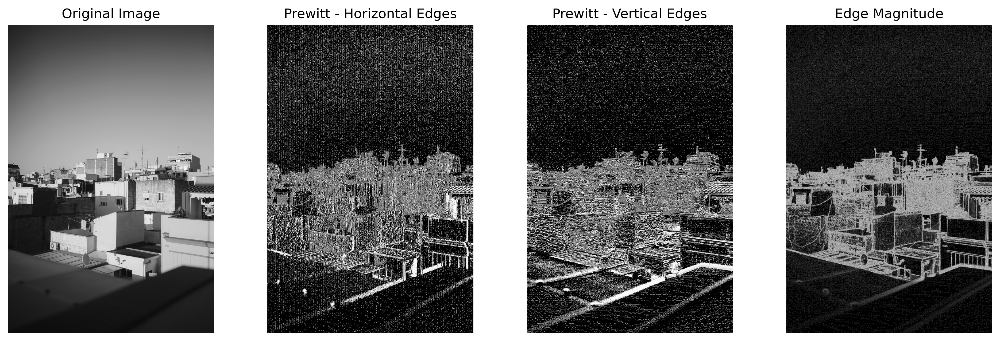

In [4]:
if __name__ == "__main__": # I'm just having fun at this point
    image_path = "/Users/elizabeth/Desktop/pics/batch1/IMG_6067.jpg"  
    prewitt_edge_detection(image_path)

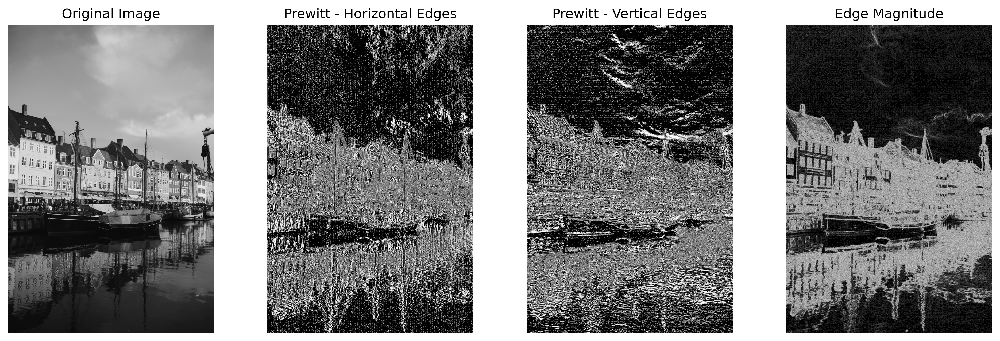

In [5]:
if __name__ == "__main__": # I'm just having fun at this point
    image_path = "/Users/elizabeth/Desktop/pics/batch1/IMG_4108.jpg"  
    prewitt_edge_detection(image_path)